In [33]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import datetime
from datetime import time

sns.set()
%matplotlib inline

In [34]:
#import data from your local C drive 
df=pd.read_csv("C:\Parking_Citations_After_July_1_2015.csv",low_memory=False)
df.head()

,Ticket number,Issue Date,Issue time,Meter Id,Marked Time,RP State Plate,VIN,Make,Body Style,Color,Location,Route,Agency,Violation code,Violation Description,Fine amount,Latitude,Longitude
0,4361370075,2019/09/17 12:00:00 AM,817.0,NaN,NaN,LA,NaN,MERC,PA,RD,1324 84TH PL W,00551,55.0,80.69BS,NO PARK/STREET CLEAN,73,6.471017e+06,1.808559e+06
1,4361370064,2019/09/17 12:00:00 AM,811.0,VM48,NaN,CA,NaN,BUIC,PA,GN,1000 85TH ST W,00551,55.0,88.13B+,METER EXP.,63,6.473192e+06,1.808298e+06
2,4361370053,2019/09/17 12:00:00 AM,809.0,NaN,NaN,CA,NaN,TOYT,PA,GY,1000 85TH ST W,00551,55.0,80.69BS,NO PARK/STREET CLEAN,73,6.473192e+06,1.808298e+06
3,4361370042,2019/09/17 12:00:00 AM,805.0,NaN,NaN,CA,NaN,NISS,PA,BK,8021 VERMONT AVE,00551,55.0,80.69BS,NO PARK/STREET CLEAN,73,6.473164e+06,1.810388e+06
4,4361370031,2019/09/17 12:00:00 AM,727.0,NaN,NaN,CA,NaN,HOND,PA,GY,1473 45TH ST W,00551,55.0,22500E,BLOCKING DRIVEWAY,68,6.469917e+06,1.823537e+06


In [35]:
#check each data type
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8706412 entries, 0 to 8706411
Data columns (total 18 columns):
Ticket number            object
Issue Date               object
Issue time               float64
Meter Id                 object
Marked Time              float64
RP State Plate           object
VIN                      float64
Make                     object
Body Style               object
Color                    object
Location                 object
Route                    object
Agency                   float64
Violation code           object
Violation Description    object
Fine amount              object
Latitude                 float64
Longitude                float64
dtypes: float64(6), object(12)
memory usage: 1.2+ GB


In [36]:
#inspect how many null values each column might have
df.apply(lambda x: sum(x.isna()),axis = 0)

Ticket number                  0
Issue Date                     0
Issue time                  2167
Meter Id                 6520291
Marked Time              8425062
RP State Plate               375
VIN                      8706412
Make                        7690
Body Style                  8478
Color                       3536
Location                     346
Route                      63715
Agency                        10
Violation code                 0
Violation Description        890
Fine amount                 5919
Latitude                       2
Longitude                      2
dtype: int64

In [12]:
# check the fomat of NaN in Issue time column
df[df['Issue time'].isna()].head()

,Ticket number,Issue Date,Issue time,Meter Id,Marked Time,RP State Plate,VIN,Make,Body Style,Color,Location,Route,Agency,Violation code,Violation Description,Fine amount,Latitude,Longitude
150556,4357912941,2019/07/18 12:00:00 AM,NaN,49,NaN,CA,NaN,TSMR,PA,BL,11300 MISSISSIPPI AVE,502A,51.0,80.58L,PREFERENTIAL PARKING,68,6.427625e+06,1.837074e+06
151789,4356818782,2019/07/18 12:00:00 AM,NaN,NaN,NaN,CA,NaN,BMW,PA,BK,221 82ND ST W,00500,55.0,22500H,DOUBLE PARKING,68,6.477808e+06,1.809783e+06
156348,4358642153,2019/07/17 12:00:00 AM,NaN,NaN,NaN,CA,NaN,JEEP,PA,WT,12047 LAMANDA ST,501R,51.0,80.56E4+,RED ZONE,93,6.432676e+06,1.822794e+06
157727,4357912801,2019/07/17 12:00:00 AM,NaN,NaN,NaN,CA,NaN,TSMR,PA,BL,2200 CARMELINA AVE,502A,51.0,5204A-,DISPLAY OF TABS,25,6.423548e+06,1.833915e+06
175255,4358528064,2019/07/12 12:00:00 AM,NaN,NaN,NaN,CA,NaN,TOYT,PA,BK,800 COMSTOCK AVE,503A,51.0,80.69B,NO PARKING,73,6.432299e+06,1.848245e+06


In [37]:
#drop nan value in column "Issue time" 
df=df.dropna(subset=['Issue time'])
df.apply(lambda x: sum(x.isna()),axis = 0)

Ticket number                  0
Issue Date                     0
Issue time                     0
Meter Id                 6518371
Marked Time              8422895
RP State Plate               375
VIN                      8704245
Make                        7662
Body Style                  8414
Color                       3496
Location                     330
Route                      63454
Agency                        10
Violation code                 0
Violation Description        877
Fine amount                 5882
Latitude                       2
Longitude                      2
dtype: int64

In [38]:
def hours(x):
    return int(x/100)+1

In [39]:
df["Hour end"] = df["Issue time"].apply(hours)
df

,Ticket number,Issue Date,Issue time,Meter Id,Marked Time,RP State Plate,VIN,Make,Body Style,Color,Location,Route,Agency,Violation code,Violation Description,Fine amount,Latitude,Longitude,Hour end
0,4361370075,2019/09/17 12:00:00 AM,817.0,NaN,NaN,LA,NaN,MERC,PA,RD,1324 84TH PL W,00551,55.0,80.69BS,NO PARK/STREET CLEAN,73,6.471017e+06,1.808559e+06,9
1,4361370064,2019/09/17 12:00:00 AM,811.0,VM48,NaN,CA,NaN,BUIC,PA,GN,1000 85TH ST W,00551,55.0,88.13B+,METER EXP.,63,6.473192e+06,1.808298e+06,9
2,4361370053,2019/09/17 12:00:00 AM,809.0,NaN,NaN,CA,NaN,TOYT,PA,GY,1000 85TH ST W,00551,55.0,80.69BS,NO PARK/STREET CLEAN,73,6.473192e+06,1.808298e+06,9
3,4361370042,2019/09/17 12:00:00 AM,805.0,NaN,NaN,CA,NaN,NISS,PA,BK,8021 VERMONT AVE,00551,55.0,80.69BS,NO PARK/STREET CLEAN,73,6.473164e+06,1.810388e+06,9
4,4361370031,2019/09/17 12:00:00 AM,727.0,NaN,NaN,CA,NaN,HOND,PA,GY,1473 45TH ST W,00551,55.0,22500E,BLOCKING DRIVEWAY,68,6.469917e+06,1.823537e+06,8
5,4361370016,2019/09/17 12:00:00 AM,611.0,NaN,NaN,CA,NaN,NISS,PA,BL,1507 FLORENCE AVE,00551,55.0,22500F,PARKED ON SIDEWALK,68,9.999900e+04,9.999900e+04,7
6,4361354034,2019/09/17 12:00:00 AM,1750.0,MD413,NaN,CA,NaN,HOND,PA,GY,1601 EASTLAKE AV,00600,56.0,88.13B+,METER EXP.,63,6.498692e+06,1.846041e+06,18
7,4361342101,2019/09/17 12:00:00 AM,1452.0,NaN,NaN,CA,NaN,FORD,PU,WT,530 LOS ANGELES ST S,00665,56.0,80.56E4+,RED ZONE,93,6.486540e+06,1.839072e+06,15
8,4361342090,2019/09/17 12:00:00 AM,1320.0,CB2607,NaN,CA,NaN,VOLK,PA,BL,402 8TH ST E,00665,56.0,88.13B+,METER EXP.,63,6.484173e+06,1.838669e+06,14
9,4361342086,2019/09/17 12:00:00 AM,1316.0,NaN,NaN,CA,NaN,MERZ,PA,SL,841 MAPLE AVE S,00665,56.0,80.56E4+,RED ZONE,93,6.485386e+06,1.837137e+06,14


In [40]:
df['Time'] = pd.to_datetime(df['Issue time'], format= '%H%M', errors= "coerce").dt.time #change time in new column

In [41]:
df['Hour start'] = df['Time'].apply(lambda x: x.hour) 
df

,Ticket number,Issue Date,Issue time,Meter Id,Marked Time,RP State Plate,VIN,Make,Body Style,Color,...,Route,Agency,Violation code,Violation Description,Fine amount,Latitude,Longitude,Hour end,Time,Hour start
0,4361370075,2019/09/17 12:00:00 AM,817.0,NaN,NaN,LA,NaN,MERC,PA,RD,...,00551,55.0,80.69BS,NO PARK/STREET CLEAN,73,6.471017e+06,1.808559e+06,9,08:17:00,8.0
1,4361370064,2019/09/17 12:00:00 AM,811.0,VM48,NaN,CA,NaN,BUIC,PA,GN,...,00551,55.0,88.13B+,METER EXP.,63,6.473192e+06,1.808298e+06,9,08:11:00,8.0
2,4361370053,2019/09/17 12:00:00 AM,809.0,NaN,NaN,CA,NaN,TOYT,PA,GY,...,00551,55.0,80.69BS,NO PARK/STREET CLEAN,73,6.473192e+06,1.808298e+06,9,08:09:00,8.0
3,4361370042,2019/09/17 12:00:00 AM,805.0,NaN,NaN,CA,NaN,NISS,PA,BK,...,00551,55.0,80.69BS,NO PARK/STREET CLEAN,73,6.473164e+06,1.810388e+06,9,08:05:00,8.0
4,4361370031,2019/09/17 12:00:00 AM,727.0,NaN,NaN,CA,NaN,HOND,PA,GY,...,00551,55.0,22500E,BLOCKING DRIVEWAY,68,6.469917e+06,1.823537e+06,8,07:27:00,7.0
5,4361370016,2019/09/17 12:00:00 AM,611.0,NaN,NaN,CA,NaN,NISS,PA,BL,...,00551,55.0,22500F,PARKED ON SIDEWALK,68,9.999900e+04,9.999900e+04,7,06:11:00,6.0
6,4361354034,2019/09/17 12:00:00 AM,1750.0,MD413,NaN,CA,NaN,HOND,PA,GY,...,00600,56.0,88.13B+,METER EXP.,63,6.498692e+06,1.846041e+06,18,17:50:00,17.0
7,4361342101,2019/09/17 12:00:00 AM,1452.0,NaN,NaN,CA,NaN,FORD,PU,WT,...,00665,56.0,80.56E4+,RED ZONE,93,6.486540e+06,1.839072e+06,15,14:52:00,14.0
8,4361342090,2019/09/17 12:00:00 AM,1320.0,CB2607,NaN,CA,NaN,VOLK,PA,BL,...,00665,56.0,88.13B+,METER EXP.,63,6.484173e+06,1.838669e+06,14,13:20:00,13.0
9,4361342086,2019/09/17 12:00:00 AM,1316.0,NaN,NaN,CA,NaN,MERZ,PA,SL,...,00665,56.0,80.56E4+,RED ZONE,93,6.485386e+06,1.837137e+06,14,13:16:00,13.0


In [63]:
#convert int"Hour end" to float "Hour end"
df['Hour end'] = df['Hour end'].astype(float)
df

,Ticket number,Issue Date,Issue time,Meter Id,Marked Time,RP State Plate,VIN,Make,Body Style,Color,...,Route,Agency,Violation code,Violation Description,Fine amount,Latitude,Longitude,Hour end,Time,Hour start
0,4361370075,2019/09/17 12:00:00 AM,817.0,NaN,NaN,LA,NaN,MERC,PA,RD,...,00551,55.0,80.69BS,NO PARK/STREET CLEAN,73,6.471017e+06,1.808559e+06,9.0,08:17:00,8.0
1,4361370064,2019/09/17 12:00:00 AM,811.0,VM48,NaN,CA,NaN,BUIC,PA,GN,...,00551,55.0,88.13B+,METER EXP.,63,6.473192e+06,1.808298e+06,9.0,08:11:00,8.0
2,4361370053,2019/09/17 12:00:00 AM,809.0,NaN,NaN,CA,NaN,TOYT,PA,GY,...,00551,55.0,80.69BS,NO PARK/STREET CLEAN,73,6.473192e+06,1.808298e+06,9.0,08:09:00,8.0
3,4361370042,2019/09/17 12:00:00 AM,805.0,NaN,NaN,CA,NaN,NISS,PA,BK,...,00551,55.0,80.69BS,NO PARK/STREET CLEAN,73,6.473164e+06,1.810388e+06,9.0,08:05:00,8.0
4,4361370031,2019/09/17 12:00:00 AM,727.0,NaN,NaN,CA,NaN,HOND,PA,GY,...,00551,55.0,22500E,BLOCKING DRIVEWAY,68,6.469917e+06,1.823537e+06,8.0,07:27:00,7.0
5,4361370016,2019/09/17 12:00:00 AM,611.0,NaN,NaN,CA,NaN,NISS,PA,BL,...,00551,55.0,22500F,PARKED ON SIDEWALK,68,9.999900e+04,9.999900e+04,7.0,06:11:00,6.0
6,4361354034,2019/09/17 12:00:00 AM,1750.0,MD413,NaN,CA,NaN,HOND,PA,GY,...,00600,56.0,88.13B+,METER EXP.,63,6.498692e+06,1.846041e+06,18.0,17:50:00,17.0
7,4361342101,2019/09/17 12:00:00 AM,1452.0,NaN,NaN,CA,NaN,FORD,PU,WT,...,00665,56.0,80.56E4+,RED ZONE,93,6.486540e+06,1.839072e+06,15.0,14:52:00,14.0
8,4361342090,2019/09/17 12:00:00 AM,1320.0,CB2607,NaN,CA,NaN,VOLK,PA,BL,...,00665,56.0,88.13B+,METER EXP.,63,6.484173e+06,1.838669e+06,14.0,13:20:00,13.0
9,4361342086,2019/09/17 12:00:00 AM,1316.0,NaN,NaN,CA,NaN,MERZ,PA,SL,...,00665,56.0,80.56E4+,RED ZONE,93,6.485386e+06,1.837137e+06,14.0,13:16:00,13.0


In [100]:
df=df.sort_values(by='Issue time', ascending=True)
df

,Ticket number,Issue Date,Issue time,Meter Id,Marked Time,RP State Plate,VIN,Make,Body Style,Color,...,Route,Agency,Violation code,Violation Description,Fine amount,Latitude,Longitude,Hour end,Time,Hour start
5059050,1110209995,2017/03/03 12:00:00 AM,0.0,NaN,NaN,CA,NaN,DODG,PA,SI,...,10A99,1.0,4000A1,NO EVIDENCE OF REG,50,9.999900e+04,9.999900e+04,1.0,NaT,NaN
6548854,4285614546,2016/06/25 12:00:00 AM,0.0,149,NaN,CA,NaN,HOND,PA,BL,...,600,56.0,80.58L,PREFERENTIAL PARKING,68,6.484147e+06,1.850370e+06,1.0,NaT,NaN
7539168,4274329651,2016/01/17 12:00:00 AM,0.0,NaN,NaN,CA,NaN,FORD,PA,GN,...,500,55.0,80.56E4+,RED ZONE,93,9.999900e+04,9.999900e+04,1.0,NaT,NaN
1525499,4342338151,2018/10/21 12:00:00 AM,0.0,53,NaN,CA,NaN,VOLV,PA,SL,...,401B,54.0,80.58L,PREFERENTIAL PARKING,68,6.457156e+06,1.853067e+06,1.0,NaT,NaN
2246872,4333147965,2018/06/03 12:00:00 AM,0.0,NaN,NaN,CA,NaN,CHEV,PA,GY,...,202A,51.0,22500E,BLOCKING DRIVEWAY,68,6.425829e+06,1.837202e+06,1.0,NaT,NaN
1110727,4346773141,2019/01/13 12:00:00 AM,0.0,70,NaN,CA,NaN,FORD,PA,WT,...,402A,54.0,80.58L,PREFERENTIAL PARKING,68,6.459026e+06,1.861937e+06,1.0,NaT,NaN
1525498,4342517454,2018/10/21 12:00:00 AM,0.0,37,NaN,VN,NaN,MERZ,PA,BK,...,402A,54.0,80.58L,PREFERENTIAL PARKING,68,6.451137e+06,1.858370e+06,1.0,NaT,NaN
803465,4349443232,2019/03/10 12:00:00 AM,0.0,NaN,NaN,CA,NaN,TOYT,PA,WT,...,402A,54.0,80.69B,NO PARKING,73,6.451336e+06,1.858250e+06,1.0,NaT,NaN
803464,4349569254,2019/03/10 12:00:00 AM,0.0,NaN,NaN,CA,NaN,MERZ,PA,SL,...,402,54.0,80.69B,NO PARKING,73,9.999900e+04,9.999900e+04,1.0,NaT,NaN
8608949,4263074734,2015/07/19 12:00:00 AM,0.0,12,NaN,CA,NaN,CHEV,PA,BK,...,402,54.0,80.58L,PREFERENTIAL PARKING,68,6.476226e+06,1.855765e+06,1.0,NaT,NaN


In [101]:
# drop unspecified location 
df=df[df['Latitude']!=99999]
df=df[df['Longitude']!=99999]
print(df['Latitude'].min(), df['Latitude'].max())
print(df['Longitude'].min(), df['Longitude'].max())

6359739.30402891 6514332.07372465
1715555.176091 1942668.996228


In [104]:
import geopandas
from geopandas import GeoDataFrame
from shapely.geometry import Point

In [105]:
#draw geo points via geo Pandas
geometry = [Point(xy) for xy in zip(df["Latitude"],df["Longitude"])] 
geometry[:3]

In [106]:
# add geo points to df
crs = {'init': 'epsg:4269'} #epsg:4362(WGS84) # crs= coordinate reference system 
df = geopandas.GeoDataFrame(df,crs = crs, geometry= geometry)
df.head()

,Ticket number,Issue Date,Issue time,Meter Id,Marked Time,RP State Plate,VIN,Make,Body Style,Color,...,Agency,Violation code,Violation Description,Fine amount,Latitude,Longitude,Hour end,Time,Hour start,geometry
6548854,4285614546,2016/06/25 12:00:00 AM,0.0,149,NaN,CA,NaN,HOND,PA,BL,...,56.0,80.58L,PREFERENTIAL PARKING,68,6.484147e+06,1.850370e+06,1.0,NaT,NaN,POINT (6484147.300 1850369.600)
1525499,4342338151,2018/10/21 12:00:00 AM,0.0,53,NaN,CA,NaN,VOLV,PA,SL,...,54.0,80.58L,PREFERENTIAL PARKING,68,6.457156e+06,1.853067e+06,1.0,NaT,NaN,POINT (6457156.252 1853066.622)
2246872,4333147965,2018/06/03 12:00:00 AM,0.0,NaN,NaN,CA,NaN,CHEV,PA,GY,...,51.0,22500E,BLOCKING DRIVEWAY,68,6.425829e+06,1.837202e+06,1.0,NaT,NaN,POINT (6425828.790 1837201.747)
1110727,4346773141,2019/01/13 12:00:00 AM,0.0,70,NaN,CA,NaN,FORD,PA,WT,...,54.0,80.58L,PREFERENTIAL PARKING,68,6.459026e+06,1.861937e+06,1.0,NaT,NaN,POINT (6459026.052 1861936.625)
1525498,4342517454,2018/10/21 12:00:00 AM,0.0,37,NaN,VN,NaN,MERZ,PA,BK,...,54.0,80.58L,PREFERENTIAL PARKING,68,6.451137e+06,1.858370e+06,1.0,NaT,NaN,POINT (6451136.778 1858370.078)


In [ ]:
# create the "Date" column to get the date
df["Date"] = df["Issue Date"].apply(lambda x: x.split()[0])
df.head()

In [120]:
df.loc[df['Agency']==56.0]['Hour end'].unique()

array([ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12., 13.,
       14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24.])

In [121]:

for i in df['Hour end'].unique():
    hr_i=df[(df['Date']=='2019/02/04')&(df['Agency']==56.0)&(df['Hour end']==i)]
    print(hr_i.head(2))

       Ticket number              Issue Date  Issue time Meter Id  \
995381    4347892076  2019/02/04 12:00:00 AM        44.0      NaN   
995380    4347892080  2019/02/04 12:00:00 AM        57.0      NaN   

        Marked Time RP State Plate  VIN  Make Body Style Color  ...  \
995381          NaN             FL  NaN  CHEV         PA    RD  ...   
995380          NaN             CA  NaN  TOYT         PA    SL  ...   

       Violation code Violation Description  Fine amount      Latitude  \
995381       80.56E4+              RED ZONE           93  6.489549e+06   
995380       80.56E4+              RED ZONE           93  6.485157e+06   

           Longitude Hour end      Time  Hour start  \
995381  1.839040e+06      1.0  04:04:00         4.0   
995380  1.838581e+06      1.0  05:07:00         5.0   

                               geometry        Date  
995381  POINT (6489549.379 1839039.733)  2019/02/04  
995380  POINT (6485157.485 1838580.868)  2019/02/04  

[2 rows x 23 columns]
    

KeyboardInterrupt: 

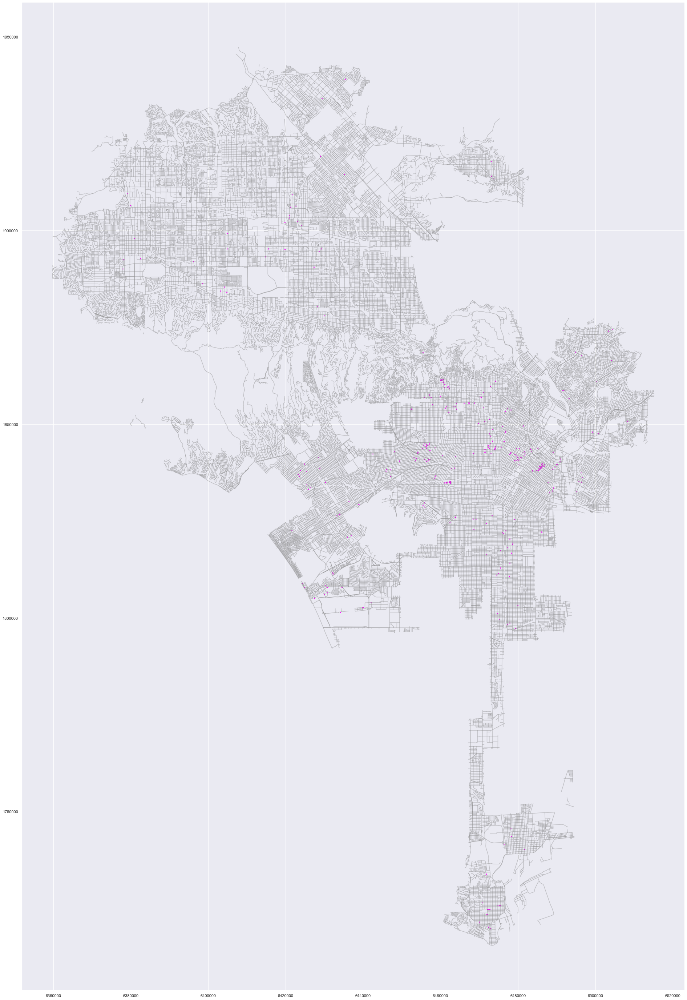

In [112]:
street_map = geopandas.read_file('Street Centerline.shp')
fig, ax = plt.subplots(figsize = (50,50))
street_map.plot(ax = ax, alpha = 0.4, color = 'grey')
for i in df['Hour end'].unique():
    hr_i=df[(df['Date']=='2019/02/04')&(df['Hour end']==i)]
    hr_i.plot(ax=ax, markersize = 5 , color = 'magenta', marker= "^",label = 'hour end _i')
#df[route_6T8].plot(ax=ax, markersize = 5 , color = 'magenta', marker= "^",label = 'route_6T8')
plt.legend(prop ={'size': 15})

C:\ProgramData\Anaconda3\lib\site-packages\geopandas\plotting.py:487: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,
No handles with labels found to put in legend.
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\ProgramData\Anac

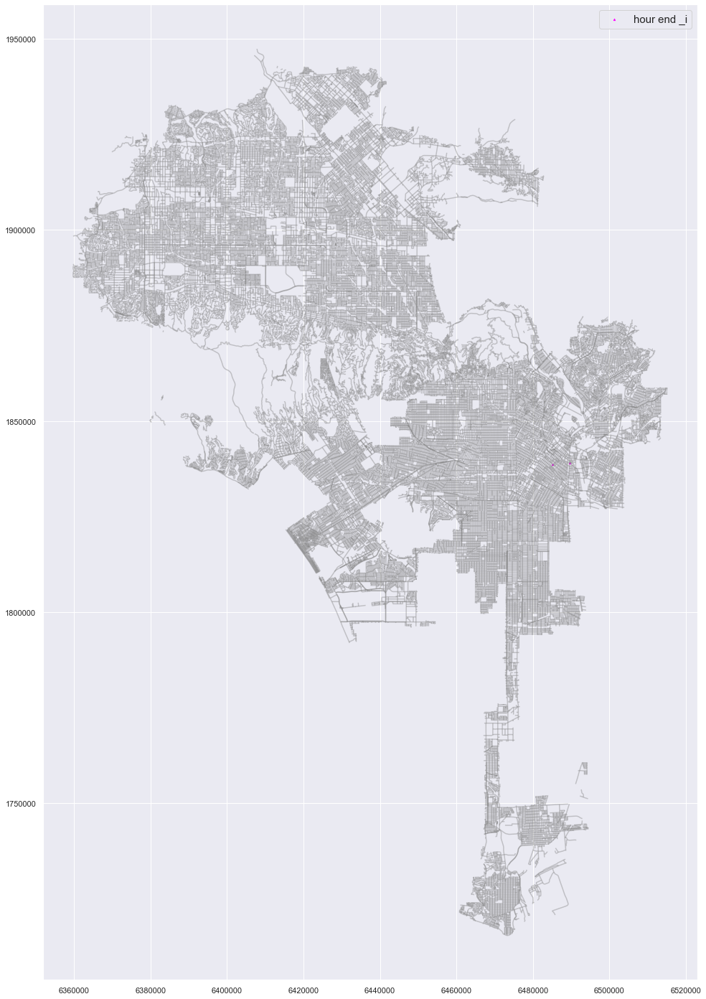

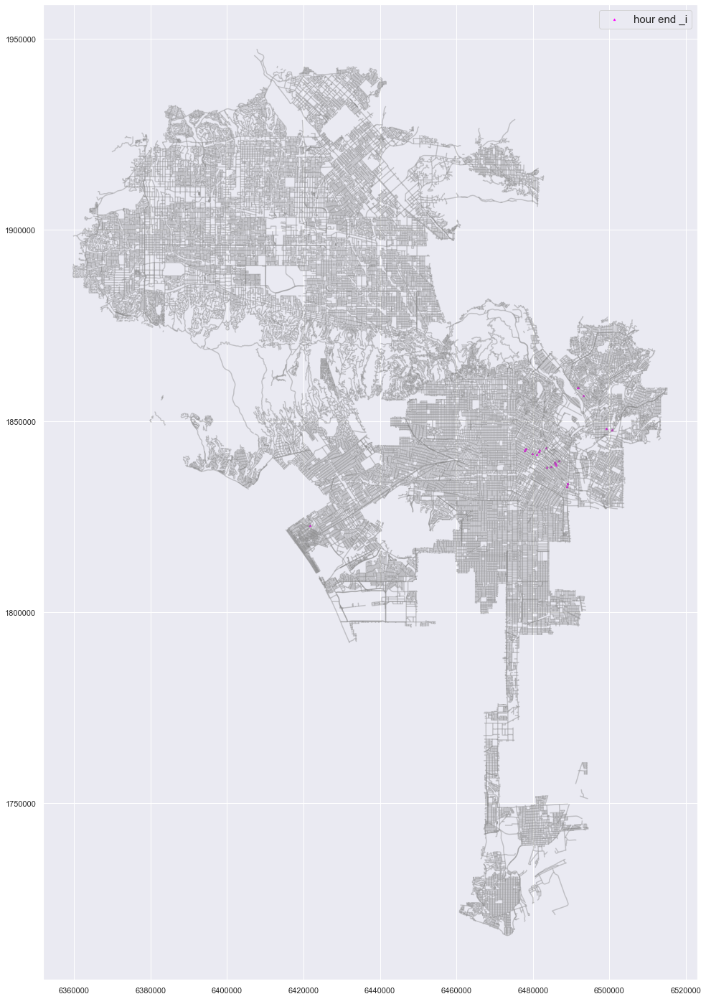

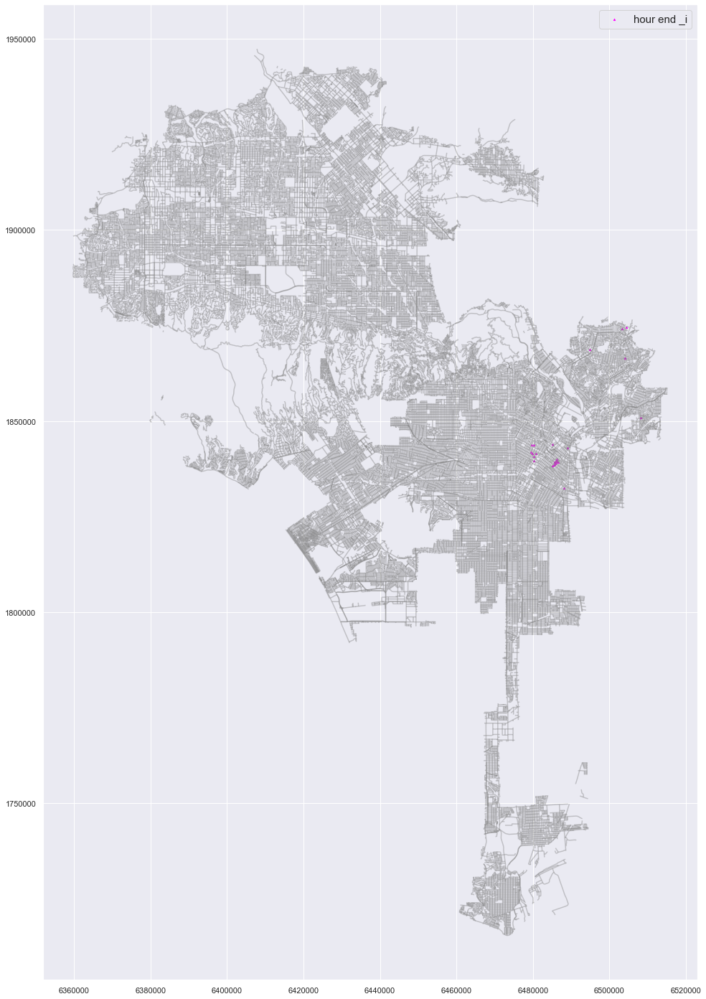

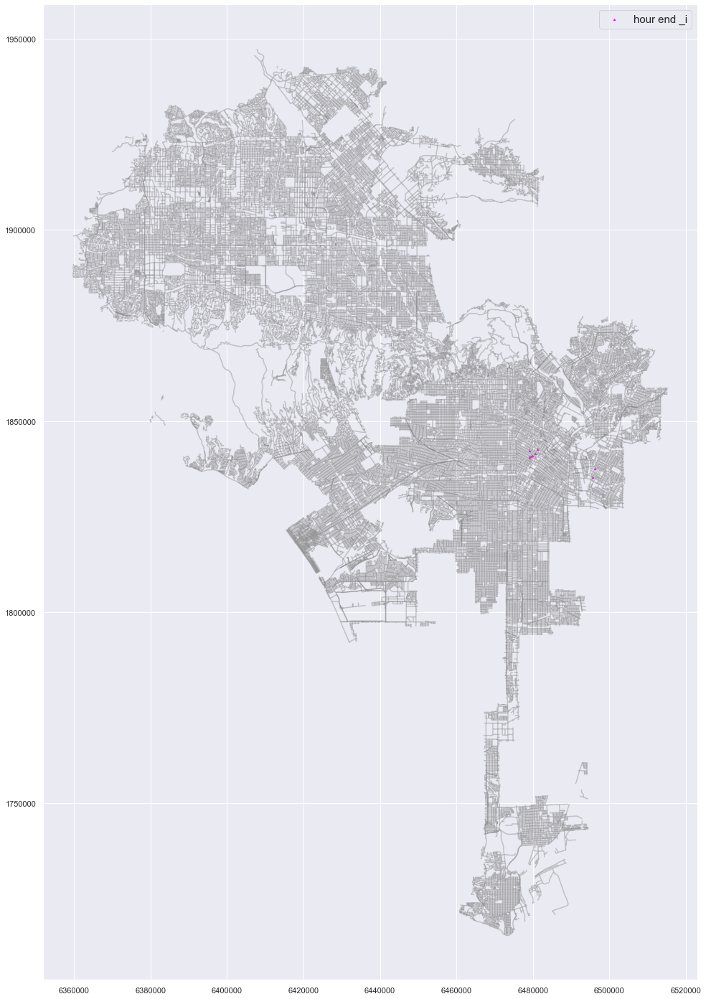

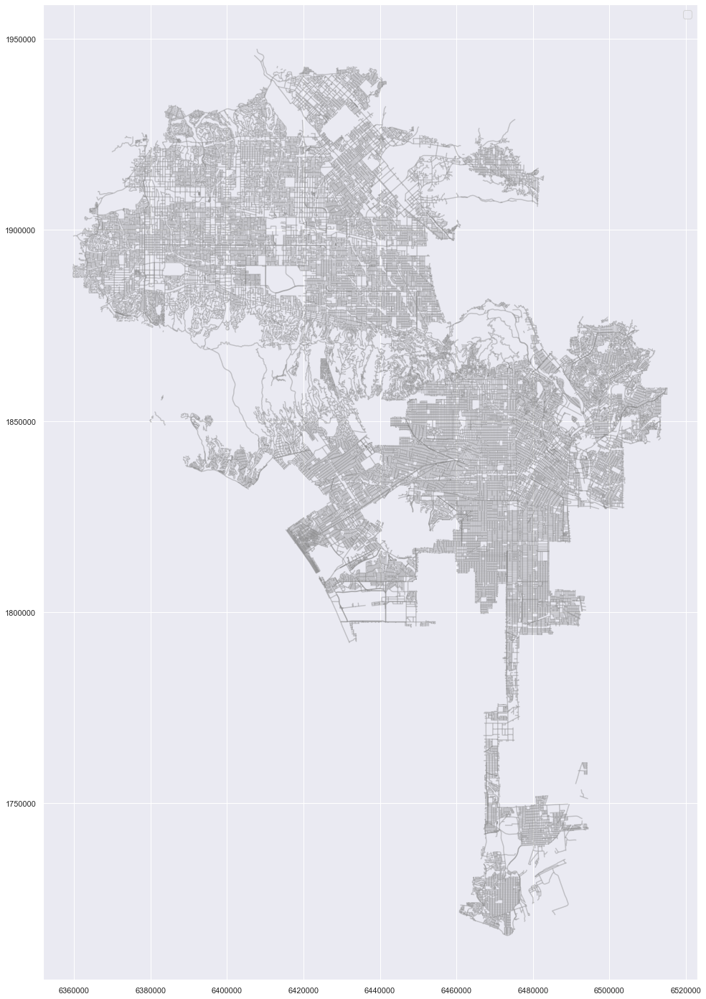

...

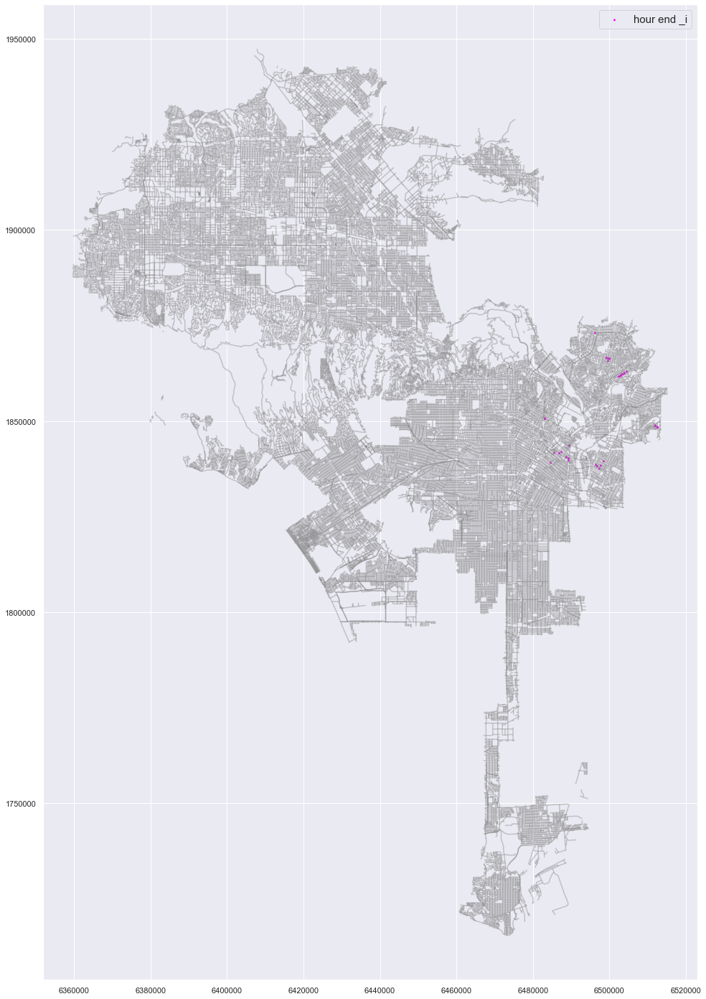

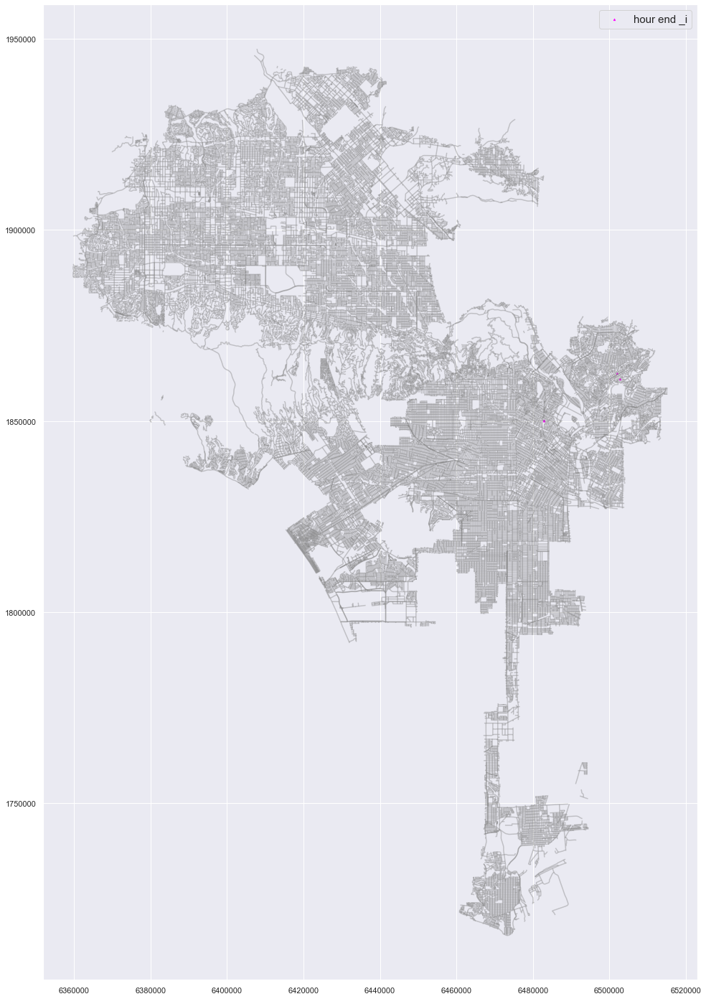

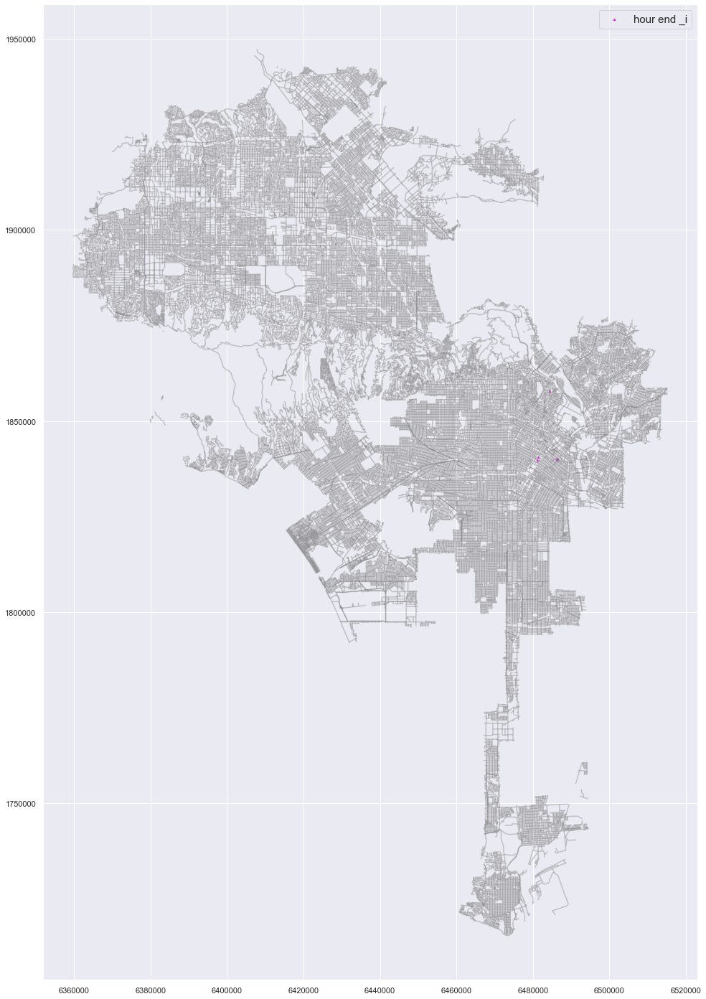

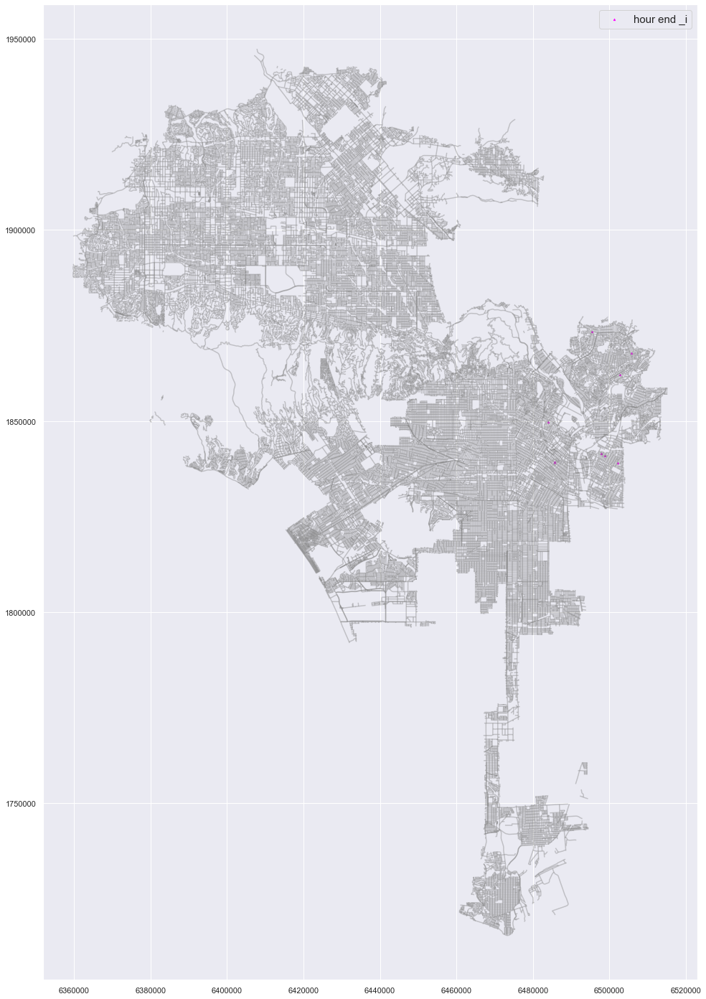

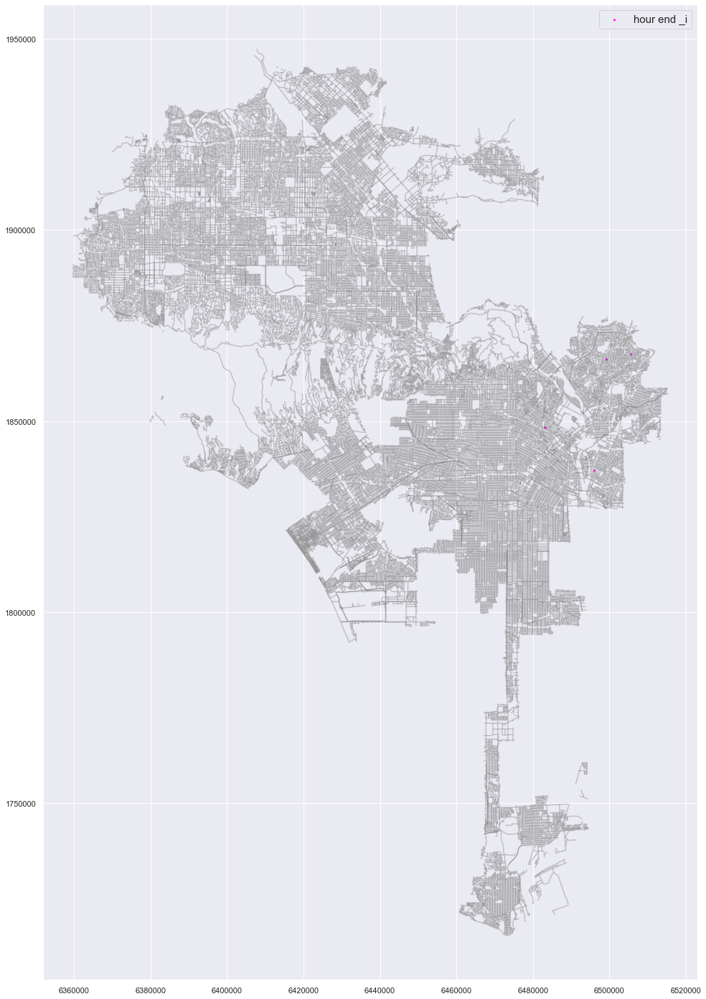

In [122]:
for i in df['Hour end'].unique():
    hr_i=df[(df['Date']=='2019/02/04')&(df['Agency']==56.0)&(df['Hour end']==i)]
    street_map = geopandas.read_file('Street Centerline.shp')
    fig, ax = plt.subplots(figsize = (25,25))
    street_map.plot(ax = ax, alpha = 0.4, color = 'grey')
    hr_i.plot(ax=ax, markersize = 5 , color = 'magenta', marker= "^",label = 'hour end _i')
    plt.legend(prop ={'size': 15})

    